# **CVPS20 // Working with Video Data in Python: Part2**

*November 19, 2020*

This notebook introduces modules to load frames from video files and concepts of working with data that has a temporal component including basic foreground/background separation techniques.

---

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

In [3]:
plt.rcParams["figure.figsize"] = [10, 8]
plt.rcParams["image.interpolation"] = "nearest"
plt.rcParams["image.cmap"] = "gist_gray"

To read in the video data from video format files (e.g., `.mp4`), we will use the [OpenCV](https://opencv.org/) package,

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
# -- define the file name
fname = "/content/drive/MyDrive/cvps20/data/dot/cctv391.mp4"

# -- create a "capture" of the video
cap = cv2.VideoCapture(fname)

The `VideoCapture` object contains information about the video, but note that the syntax of OpenCV is a bit archaic (and has remnants of `C++` styling, its original design language),

In [6]:
cv2.CAP_PROP_FRAME_COUNT

7

In [7]:
int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

100

In [8]:
cap.get(cv2.CAP_PROP_FRAME_HEIGHT)

240.0

This frame capture can be read frame by frame using the `.read()` method,

In [9]:
vals = cap.read()

This is now a `numpy` array and can be treated as such, with a small catch,

In [10]:
st, fr = cap.read()

In [11]:
fr.shape

(240, 352, 3)

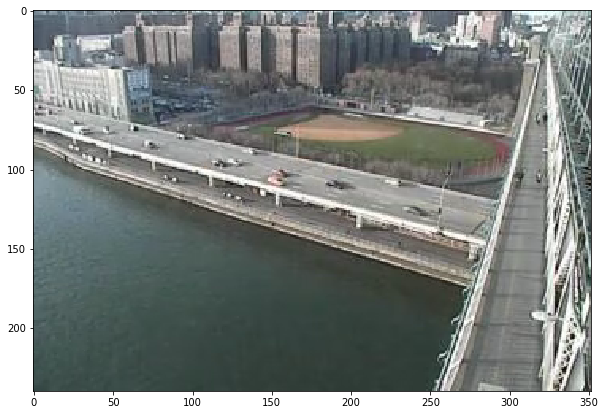

In [12]:
plt.imshow(fr[:, :, ::-1])

If we want to read in the whole videos (or the first `N` frames), it's typically best practices to create an empty array, and then load each frame into that array,

In [13]:
# -- create a "capture" of the video
cap = cv2.VideoCapture(fname)

# -- get parameters of the video
nframe = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
nrow = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
ncol = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))

# -- create a container for the images
imgs = np.zeros((nframe, nrow, ncol, 3), dtype=float)

# -- loop through frames
for ii in range(nframe):
  imgs[ii] = cap.read()[1][:, :, ::-1] / 255.

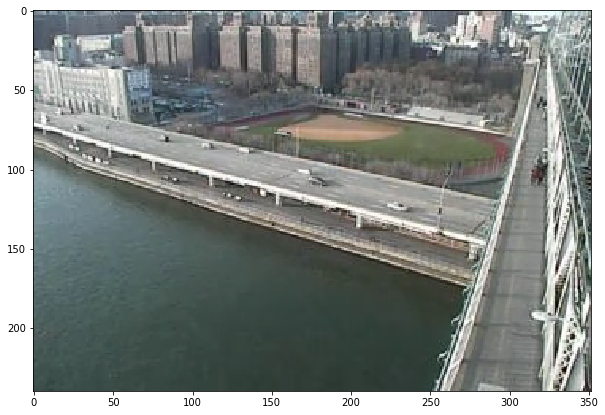

In [14]:
# -- display a frame
fig, ax = plt.subplots()
ax.imshow(imgs[99])
fig.show()

In [15]:
ncol

352

Now let's view the whole video using `matplotlib`'s `animation` sub-module

In [16]:
from matplotlib import animation

In [17]:
# -- define how the animation should be encoded within the HTML
plt.rcParams["animation.html"] = "jshtml"

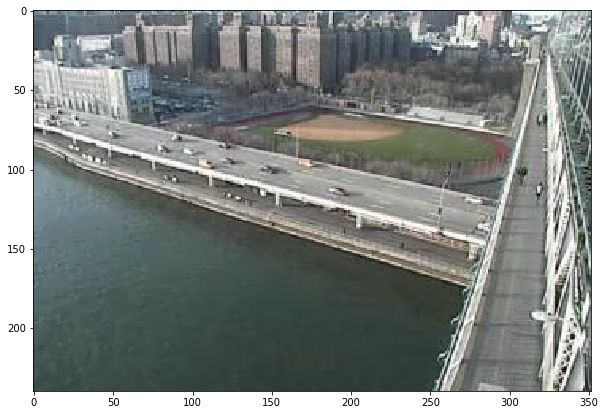

In [18]:
# -- initialize the plot
fig, ax = plt.subplots()
im = ax.imshow(imgs[0])

# -- define a function to modify the plot
def animate(i):
  im.set_data(imgs[i])

# -- create the animation
ani = animation.FuncAnimation(fig, animate, frames=nframe)

In [ ]:
ani

Animation size has reached 21158513 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


For some of the processing we'll do below, we'll want to consider luminosity images instead of 3 color,

In [19]:
imgs.shape

(100, 240, 352, 3)

In [20]:
# -- create the luminosity frames
imgsL = imgs.mean(axis=-1)

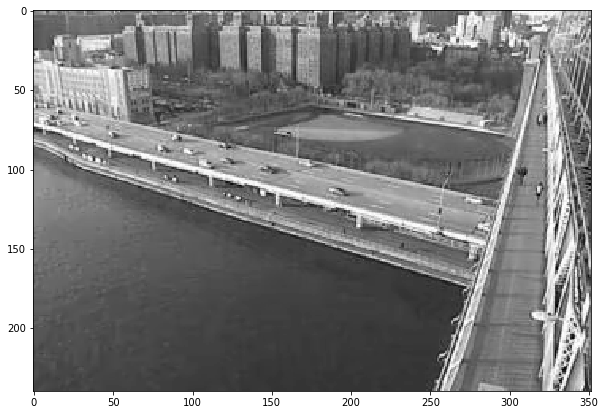

In [21]:
plt.imshow(imgsL[0])

Now, let's look at the ***timeseries*** one particular pixel

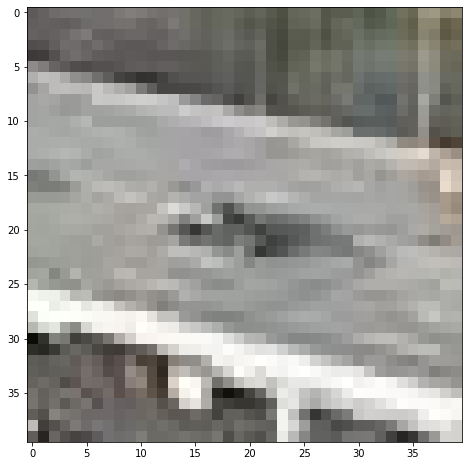

In [22]:
plt.imshow(imgs[0, 80:120, 130:170])

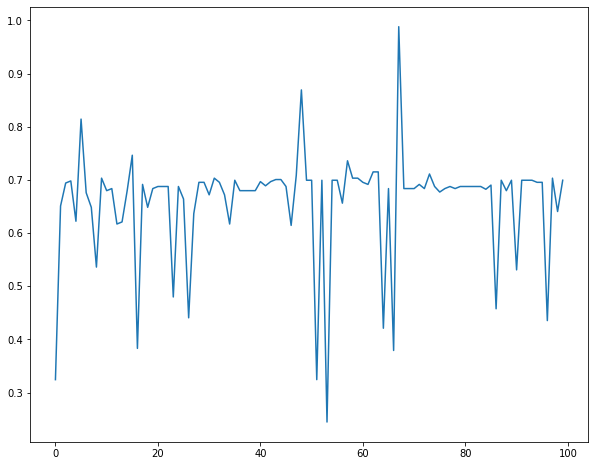

In [26]:
plt.plot(imgsL[:, 100, 150])

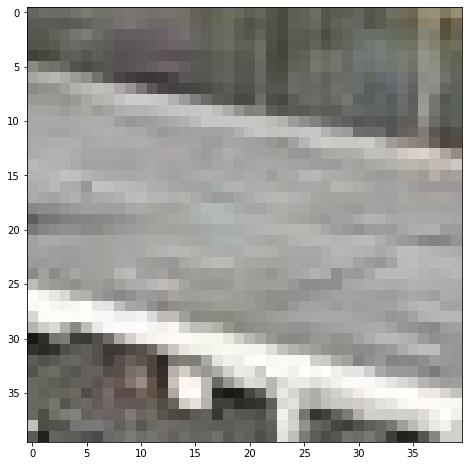

In [24]:
plt.imshow(imgs[80, 80:120, 130:170])

**Create a mean <u>*image*</u>, display it, and subtract from all frames (taking the absolute value).**

In [27]:
# -- create mean image
avg = imgs.mean(axis=0)

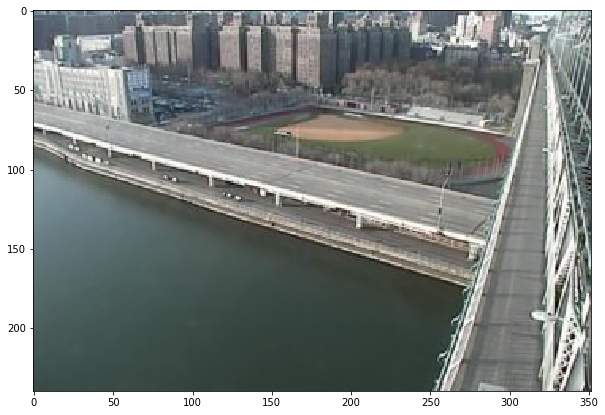

In [ ]:
plt.imshow(avg)

In [47]:
# -- create a residual
res = np.abs(imgs - avg)

In [49]:
imgs.shape

(100, 240, 352, 3)

In [50]:
avg.shape

(240, 352, 3)

In [51]:
res.shape

(100, 240, 352, 3)

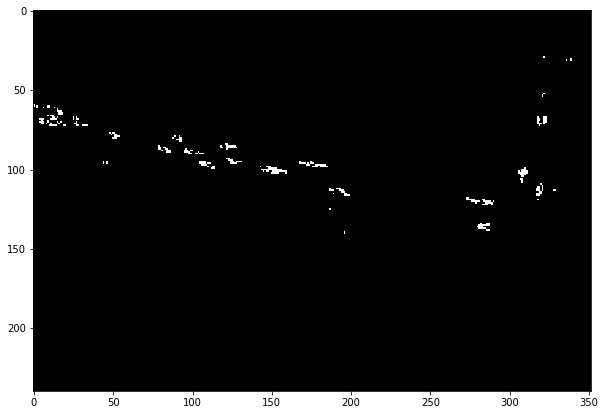

In [52]:
# -- show the residual
plt.imshow(res[0].mean(axis=-1) > 0.2, clim=[0, 0.3])